Homework 0

Christopher Beam

800927396

### Problem 1

In [1]:
# Required imports
from torchvision import models
import torch
from PIL import Image
from torchvision import transforms

In [2]:
# Generate the model, collect the labels, and initalize Resnet
resnet = models.resnet101(pretrained=True)
with open('../Data/Homework0/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]
resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [3]:
# Preprocess for images
preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        )])
preprocess2 = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224)
        ])

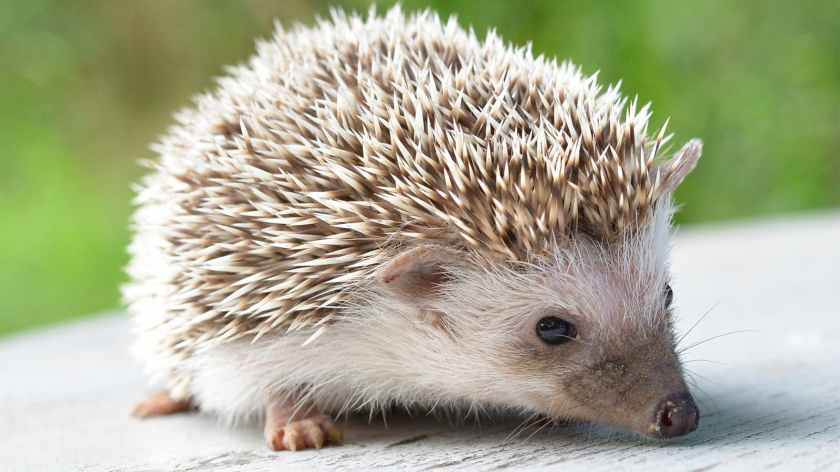

In [4]:
# Image for processing and evaluating
img = Image.open("../Data/Homework0/hedgehog.jpg")
img

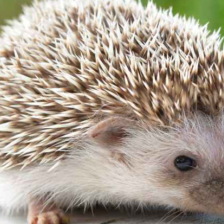

In [5]:
# Preprocess image
img_t = preprocess(img)
img_t2 = preprocess2(img)
# Preprocessed image
img_t2

In [6]:
# Batch the image
batch_t = torch.unsqueeze(img_t, 0)

In [7]:
# Evaluate the image and find the index for the max label
out = resnet(batch_t)
_, index = torch.max(out, 1)

In [8]:
# Get the top result of the evaluated image
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('porcupine, hedgehog', 99.72889709472656)

In [9]:
# Get the top 5 results of the evaluated image
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('porcupine, hedgehog', 99.72889709472656),
 ('echidna, spiny anteater, anteater', 0.08287858963012695),
 ('meerkat, mierkat', 0.022194799035787582),
 ('polecat, fitch, foulmart, foumart, Mustela putorius', 0.020525071769952774),
 ('weasel', 0.006436034105718136)]

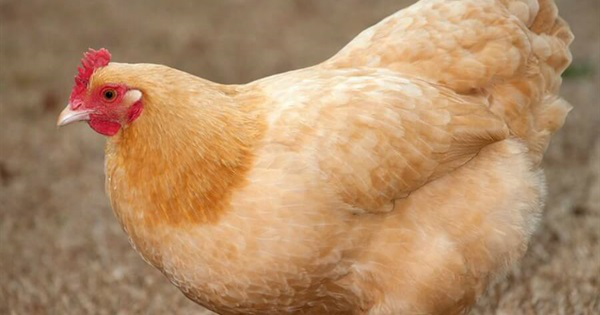

In [10]:
# Image for processing and evaluating
img = Image.open("../Data/Homework0/chicken.jpg")
img

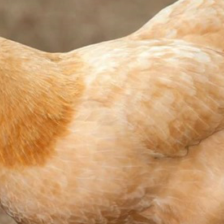

In [11]:
# Preprocess image
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [12]:
# Batch the image
batch_t = torch.unsqueeze(img_t, 0)

In [13]:
# Evaluate the image and find the index for the max label
out = resnet(batch_t)
_, index = torch.max(out, 1)

In [14]:
# Get the top result of the evaluated image
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('hen', 99.72811889648438)

In [15]:
# Get the top 5 results of the evaluated image
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('hen', 99.72811889648438),
 ('partridge', 0.08102461695671082),
 ('cock', 0.051276251673698425),
 ('flamingo', 0.023376919329166412),
 ('goose', 0.016361577436327934)]

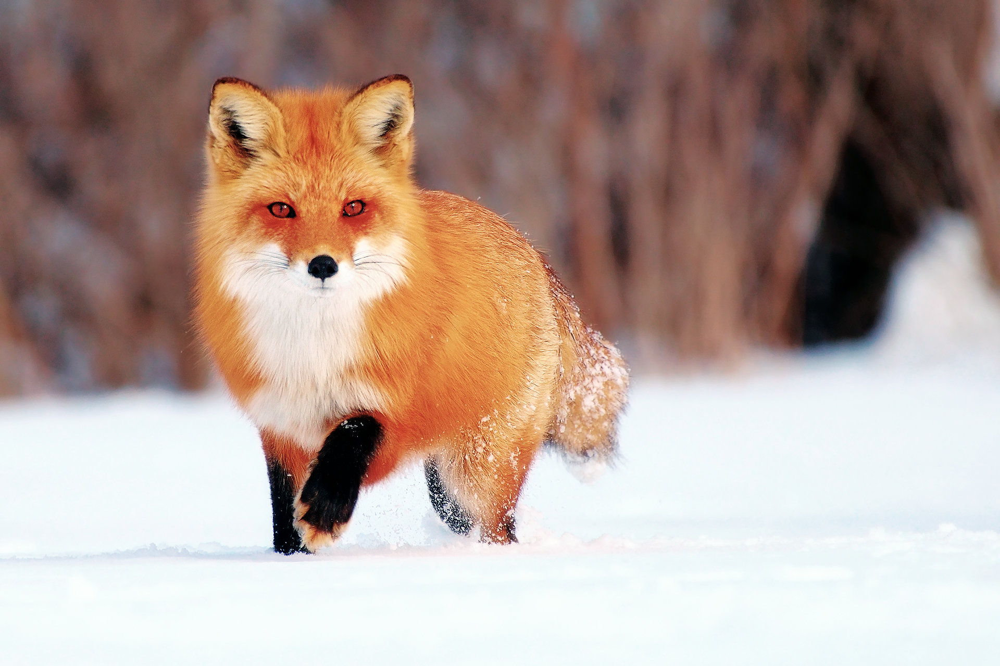

In [16]:
img = Image.open("../Data/Homework0/fox.jpg")
img

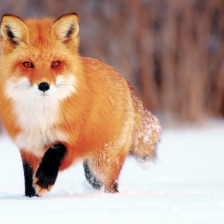

In [17]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [18]:
batch_t = torch.unsqueeze(img_t, 0)

In [19]:
out = resnet(batch_t)
_, index = torch.max(out, 1)

In [20]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('red fox, Vulpes vulpes', 94.83055877685547)

In [21]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('red fox, Vulpes vulpes', 94.83055877685547),
 ('kit fox, Vulpes macrotis', 3.430546522140503),
 ('grey fox, gray fox, Urocyon cinereoargenteus', 0.7153975367546082),
 ('Arctic fox, white fox, Alopex lagopus', 0.5389819145202637),
 ('coyote, prairie wolf, brush wolf, Canis latrans', 0.10537964105606079)]

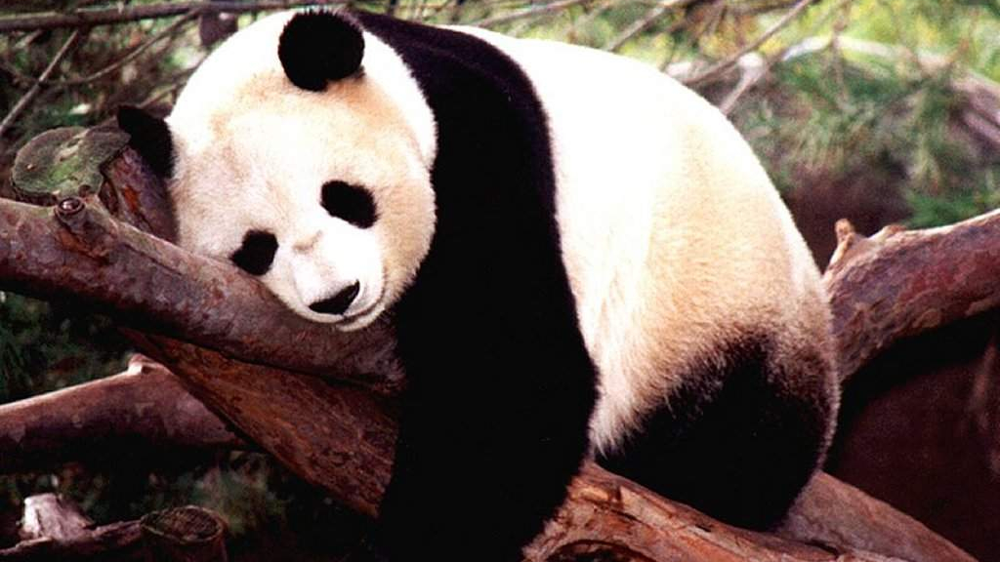

In [22]:
img = Image.open("../Data/Homework0/panda.jpg")
img

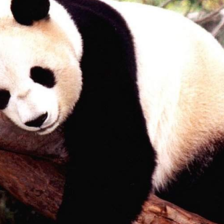

In [23]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [24]:
batch_t = torch.unsqueeze(img_t, 0)

In [25]:
out = resnet(batch_t)
_, index = torch.max(out, 1)

In [26]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('giant panda, panda, panda bear, coon bear, Ailuropoda melanoleuca',
 99.96420288085938)

In [27]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('giant panda, panda, panda bear, coon bear, Ailuropoda melanoleuca',
  99.96420288085938),
 ('lesser panda, red panda, panda, bear cat, cat bear, Ailurus fulgens',
  0.015233170241117477),
 ('indri, indris, Indri indri, Indri brevicaudatus', 0.007301695644855499),
 ('teddy, teddy bear', 0.0019585939589887857),
 ('cougar, puma, catamount, mountain lion, painter, panther, Felis concolor',
  0.0015386644518002868)]

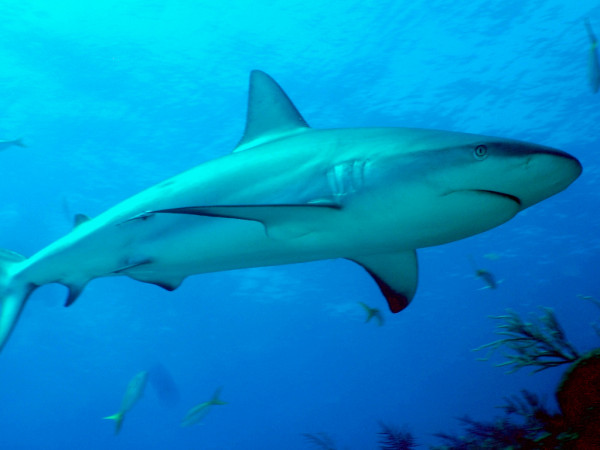

In [28]:
img = Image.open("../Data/Homework0/caribbean-reef-shark.jpg")
img

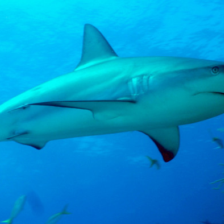

In [29]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [30]:
batch_t = torch.unsqueeze(img_t, 0)

In [31]:
out = resnet(batch_t)
_, index = torch.max(out, 1)

In [32]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('hammerhead, hammerhead shark', 49.9366569519043)

In [33]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('hammerhead, hammerhead shark', 49.9366569519043),
 ('tiger shark, Galeocerdo cuvieri', 42.99036407470703),
 ('great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
  5.793252944946289),
 ('electric ray, crampfish, numbfish, torpedo', 0.6328141689300537),
 ('stingray', 0.15629637241363525)]

### Problem 2

In [34]:
# Create the ResNetGenerator
import torch.nn as nn

class ResNetBlock(nn.Module): # <1>

    def __init__(self, dim):
        super(ResNetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim)

    def build_conv_block(self, dim):
        conv_block = []

        conv_block += [nn.ReflectionPad2d(1)]

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                       nn.InstanceNorm2d(dim),
                       nn.ReLU(True)]

        conv_block += [nn.ReflectionPad2d(1)]

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                       nn.InstanceNorm2d(dim)]

        return nn.Sequential(*conv_block)

    def forward(self, x):
        out = x + self.conv_block(x) # <2>
        return out


class ResNetGenerator(nn.Module):

    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=9): # <3> 

        assert(n_blocks >= 0)
        super(ResNetGenerator, self).__init__()

        self.input_nc = input_nc
        self.output_nc = output_nc
        self.ngf = ngf

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=True),
                 nn.InstanceNorm2d(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2**i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3,
                                stride=2, padding=1, bias=True),
                      nn.InstanceNorm2d(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2**n_downsampling
        for i in range(n_blocks):
            model += [ResNetBlock(ngf * mult)]

        for i in range(n_downsampling):
            mult = 2**(n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1,
                                         bias=True),
                      nn.InstanceNorm2d(int(ngf * mult / 2)),
                      nn.ReLU(True)]

        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, input): # <3>
        return self.model(input)

In [35]:
# Load the model parameter values into the generator
netG = ResNetGenerator()
model_path = '../Data/Homework0/horse2zebra_0.4.0.pth'
model_data = torch.load(model_path)
netG.load_state_dict(model_data)

<All keys matched successfully>

In [36]:
# Evaluate the generator
netG.eval()

ResNetGenerator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace=True)
    (10): ResNetBlock(
      (conv_block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
        (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (3): ReLU(inplace=True)
        (4): ReflectionPad2d((1, 1, 1, 1))
     

In [37]:
# Preprocess for images
preprocess = transforms.Compose([transforms.Resize(256),
                                 transforms.ToTensor()])

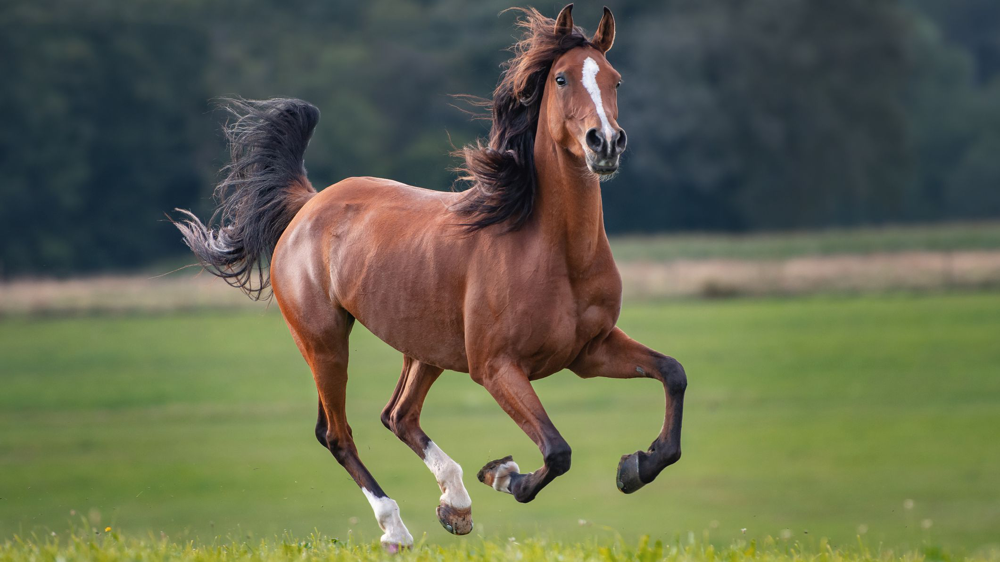

In [38]:
# Image for processing
img = Image.open("../Data/Homework0/horse.jpg")
img

In [39]:
# Preprocess image and send it through the generator
img_t = preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)
batch_out = netG(batch_t)

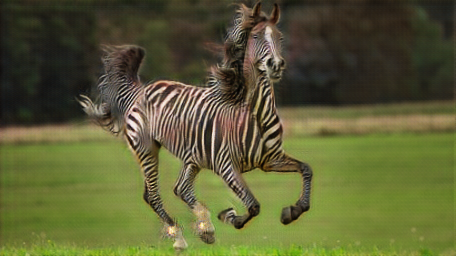

In [40]:
# Generate and display the output image
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
# out_img.save('../data/p1ch2/zebra.jpg')
out_img

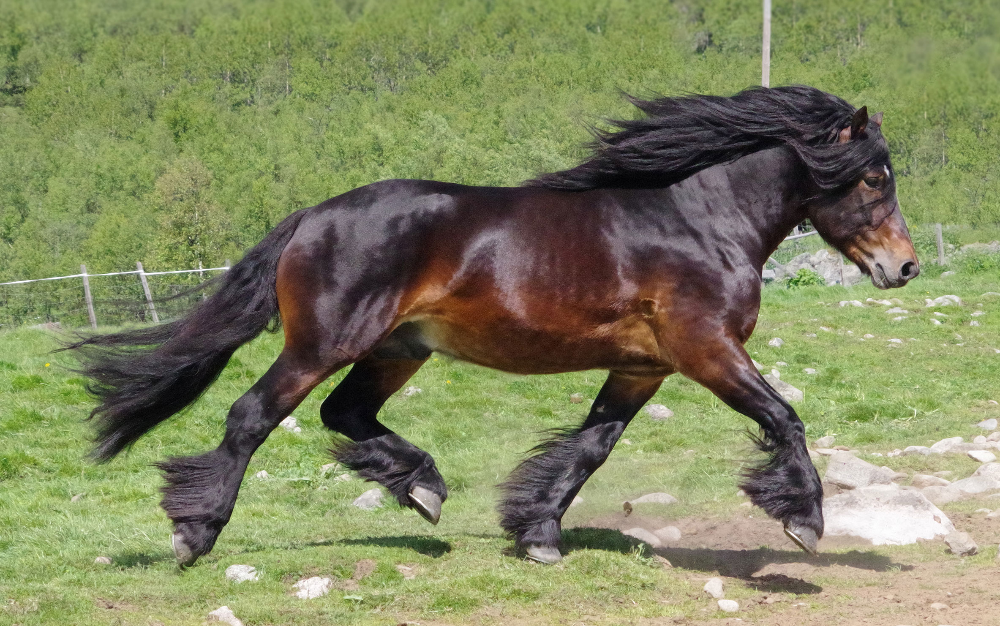

In [41]:
img = Image.open("../Data/Homework0/horse2.jpg")
img

In [42]:
img_t = preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)
batch_out = netG(batch_t)

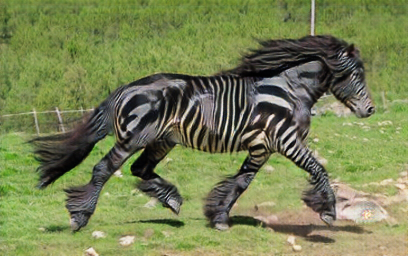

In [43]:
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
# out_img.save('../data/p1ch2/zebra.jpg')
out_img

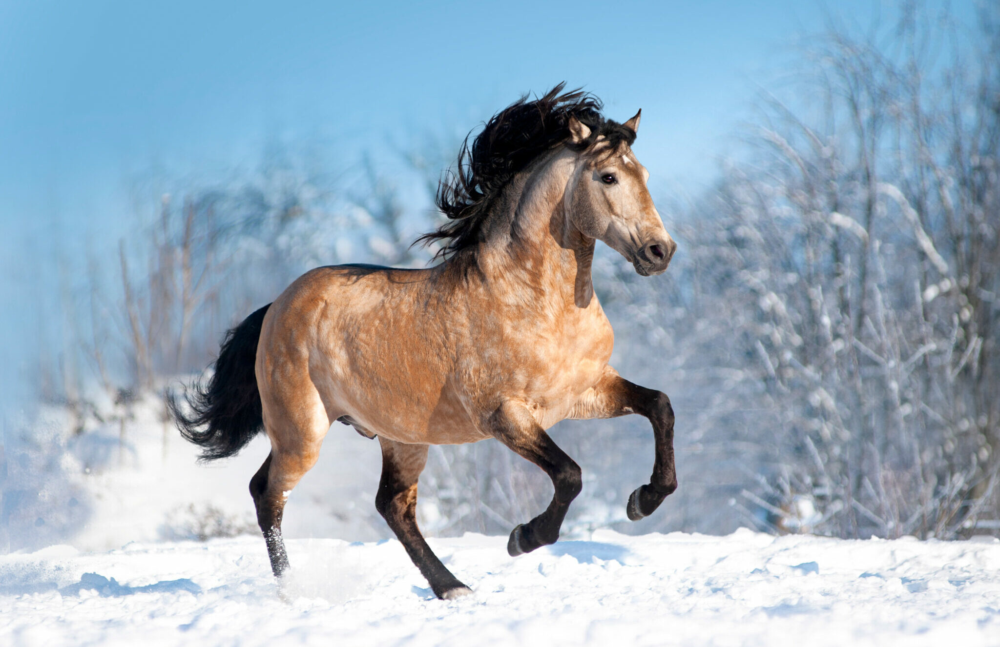

In [44]:
img = Image.open("../Data/Homework0/horse-in-snow.jpg")
img

In [45]:
img_t = preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)
batch_out = netG(batch_t)

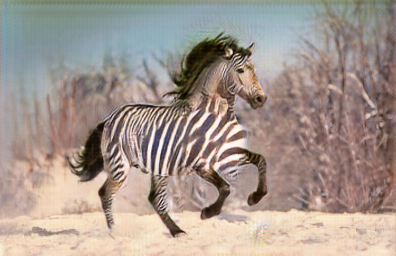

In [46]:
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
# out_img.save('../data/p1ch2/zebra.jpg')
out_img

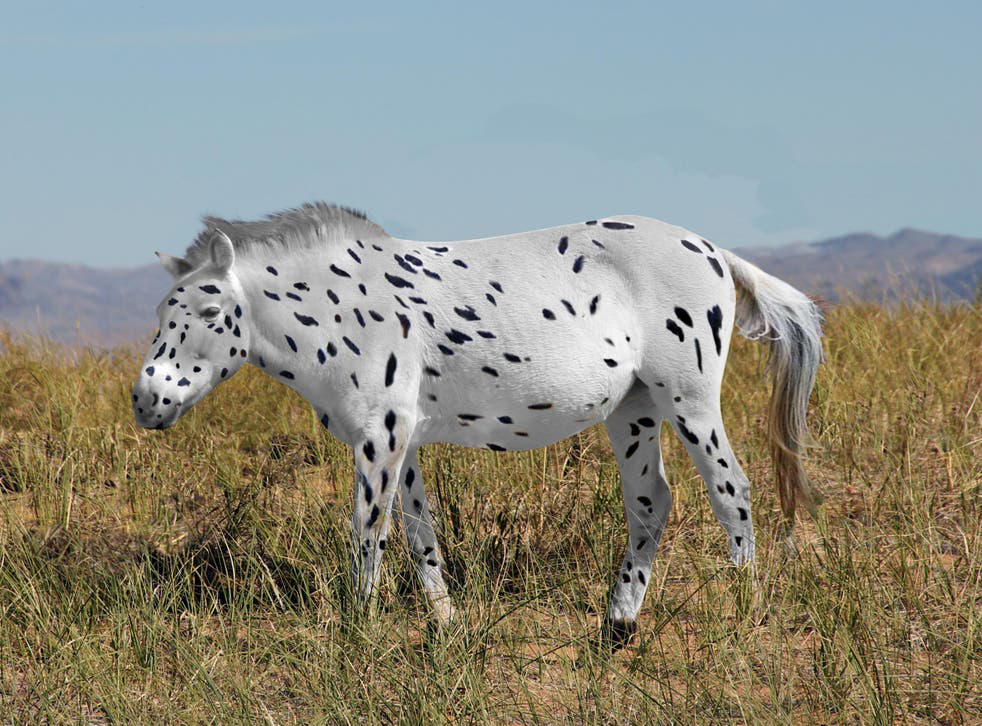

In [47]:
img = Image.open("../Data/Homework0/spotted-horse.jpg")
img

In [48]:
img_t = preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)
batch_out = netG(batch_t)

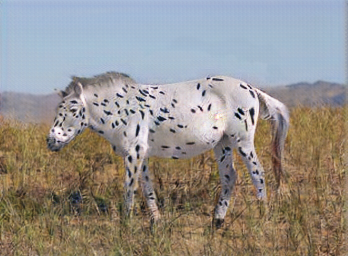

In [49]:
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
# out_img.save('../data/p1ch2/zebra.jpg')
out_img

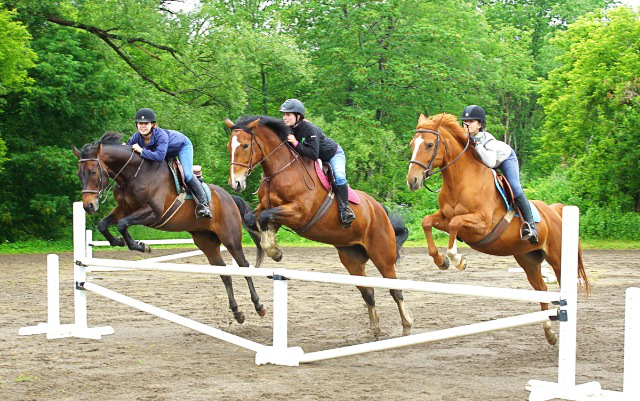

In [50]:
img = Image.open("../Data/Homework0/three-horses.jpg")
img

In [51]:
img_t = preprocess(img)
batch_t = torch.unsqueeze(img_t, 0)
batch_out = netG(batch_t)

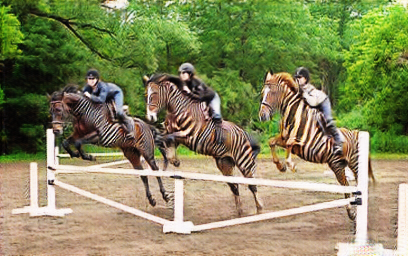

In [52]:
out_t = (batch_out.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t)
# out_img.save('../data/p1ch2/zebra.jpg')
out_img

### Problem 3

In [53]:
# Import ptflops
from ptflops import get_model_complexity_info

In [54]:
# Calculate the MACs and size of the resnet model
macs, params = get_model_complexity_info(resnet, (3, 224, 224), as_strings=True,
                                           print_per_layer_stat=True, verbose=True)
print('{:<30}  {:<8}'.format('Computational complexity: ', macs))
print('{:<30}  {:<8}'.format('Number of parameters: ', params))

ResNet(
  44.549 M, 100.000% Params, 7.85 GMac, 100.000% MACs, 
  (conv1): Conv2d(0.009 M, 0.021% Params, 0.118 GMac, 1.503% MACs, 3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(0.0 M, 0.000% Params, 0.002 GMac, 0.020% MACs, 64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(0.0 M, 0.000% Params, 0.001 GMac, 0.010% MACs, inplace=True)
  (maxpool): MaxPool2d(0.0 M, 0.000% Params, 0.001 GMac, 0.010% MACs, kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    0.216 M, 0.484% Params, 0.68 GMac, 8.668% MACs, 
    (0): Bottleneck(
      0.075 M, 0.168% Params, 0.236 GMac, 3.012% MACs, 
      (conv1): Conv2d(0.004 M, 0.009% Params, 0.013 GMac, 0.164% MACs, 64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(0.0 M, 0.000% Params, 0.0 GMac, 0.005% MACs, 64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(0.037 M, 0.0

In [55]:
# Calculate the MACs and size of the resnetgenerator model
macs, params = get_model_complexity_info(netG, (3, 224, 224), as_strings=True,
                                           print_per_layer_stat=True, verbose=True)
print('{:<30}  {:<8}'.format('Computational complexity: ', macs))
print('{:<30}  {:<8}'.format('Number of parameters: ', params))

ResNetGenerator(
  11.378 M, 100.000% Params, 43.555 GMac, 100.000% MACs, 
  (model): Sequential(
    11.378 M, 100.000% Params, 43.555 GMac, 100.000% MACs, 
    (0): ReflectionPad2d(0.0 M, 0.000% Params, 0.0 GMac, 0.000% MACs, (3, 3, 3, 3))
    (1): Conv2d(0.009 M, 0.083% Params, 0.475 GMac, 1.091% MACs, 3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(0.0 M, 0.000% Params, 0.003 GMac, 0.007% MACs, 64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(0.0 M, 0.000% Params, 0.003 GMac, 0.007% MACs, inplace=True)
    (4): Conv2d(0.074 M, 0.649% Params, 0.926 GMac, 2.127% MACs, 64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(0.0 M, 0.000% Params, 0.002 GMac, 0.004% MACs, 128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(0.0 M, 0.000% Params, 0.002 GMac, 0.004% MACs, inplace=True)
    (7): Conv2d(0.295 M, 2.594% Params, 0.926 GMac, 2.125% MACs, 128, 256, kernel_size=(3, 3)

### Problem 4

In [56]:
# Generate a pretrained mobilenet model and evaluate it
mobnet = torch.hub.load('pytorch/vision:v0.10.0', 'mobilenet_v2', pretrained=True)
mobnet.eval()

Using cache found in C:\Users\Grey/.cache\torch\hub\pytorch_vision_v0.10.0


MobileNetV2(
  (features): Sequential(
    (0): ConvNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): ConvNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidual(
      (conv): Sequential(
        (0): ConvNormActivation(
          (0): Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(96, eps=1e-05,

In [57]:
# Use the same preprocess steps as used in problem 1
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

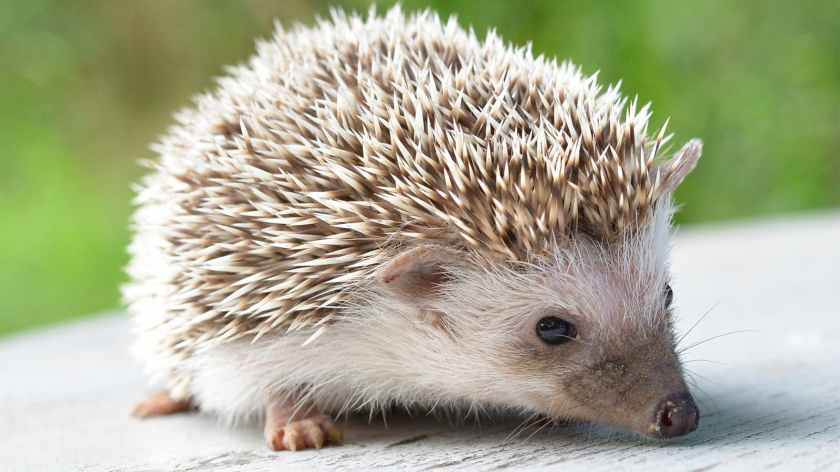

In [58]:
# Evaluate each image in the same procress as problem 1
img = Image.open("../Data/Homework0/hedgehog.jpg")
img

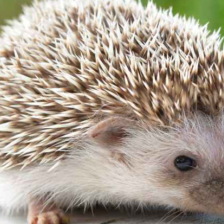

In [59]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [60]:
batch_t = torch.unsqueeze(img_t, 0)

In [61]:
out = mobnet(batch_t)
_, index = torch.max(out, 1)

In [62]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('porcupine, hedgehog', 99.85497283935547)

In [63]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('porcupine, hedgehog', 99.85497283935547),
 ('polecat, fitch, foulmart, foumart, Mustela putorius', 0.05533171445131302),
 ('weasel', 0.026627708226442337),
 ('black-footed ferret, ferret, Mustela nigripes', 0.023999027907848358),
 ('meerkat, mierkat', 0.011314046569168568)]

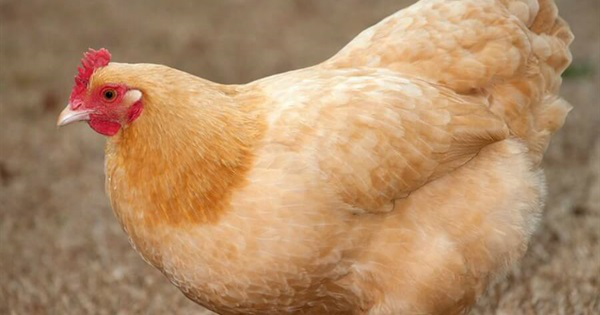

In [64]:
img = Image.open("../Data/Homework0/chicken.jpg")
img

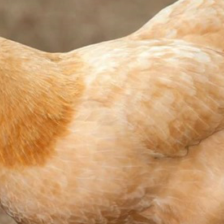

In [65]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [66]:
batch_t = torch.unsqueeze(img_t, 0)

In [67]:
out = mobnet(batch_t)
_, index = torch.max(out, 1)

In [68]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('hen', 99.78340148925781)

In [69]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('hen', 99.78340148925781),
 ('cock', 0.15116648375988007),
 ('flamingo', 0.012553366832435131),
 ('partridge', 0.008450346998870373),
 ('proboscis monkey, Nasalis larvatus', 0.006501121446490288)]

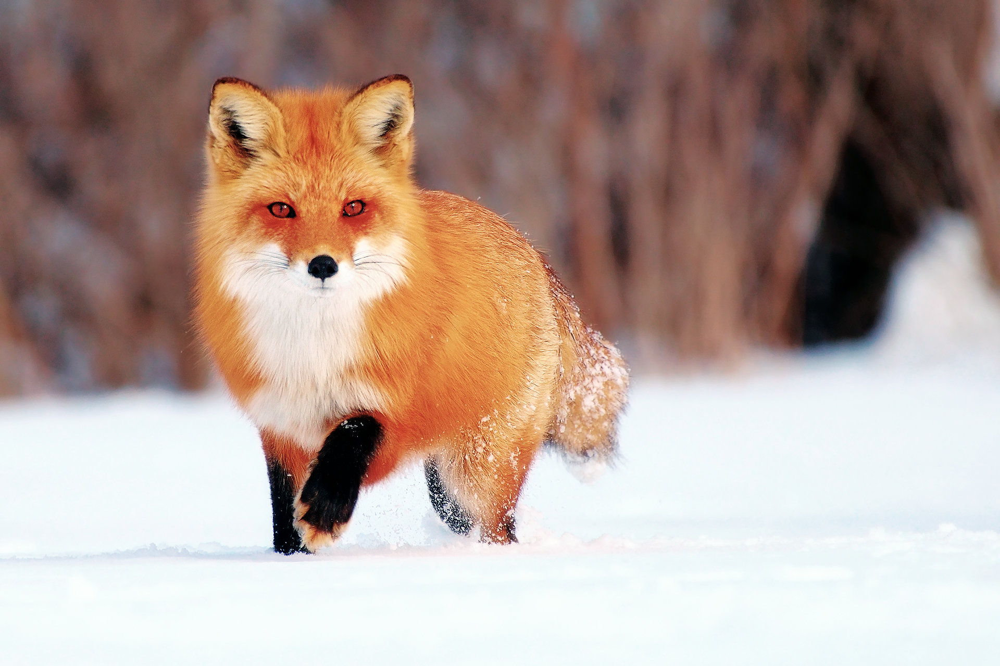

In [70]:
img = Image.open("../Data/Homework0/fox.jpg")
img

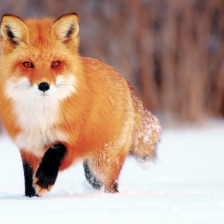

In [71]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [72]:
batch_t = torch.unsqueeze(img_t, 0)

In [73]:
out = mobnet(batch_t)
_, index = torch.max(out, 1)

In [74]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('red fox, Vulpes vulpes', 94.87842559814453)

In [75]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('red fox, Vulpes vulpes', 94.87842559814453),
 ('kit fox, Vulpes macrotis', 2.2196896076202393),
 ('grey fox, gray fox, Urocyon cinereoargenteus', 1.9752798080444336),
 ('Arctic fox, white fox, Alopex lagopus', 0.3061438202857971),
 ('Pomeranian', 0.1690659373998642)]

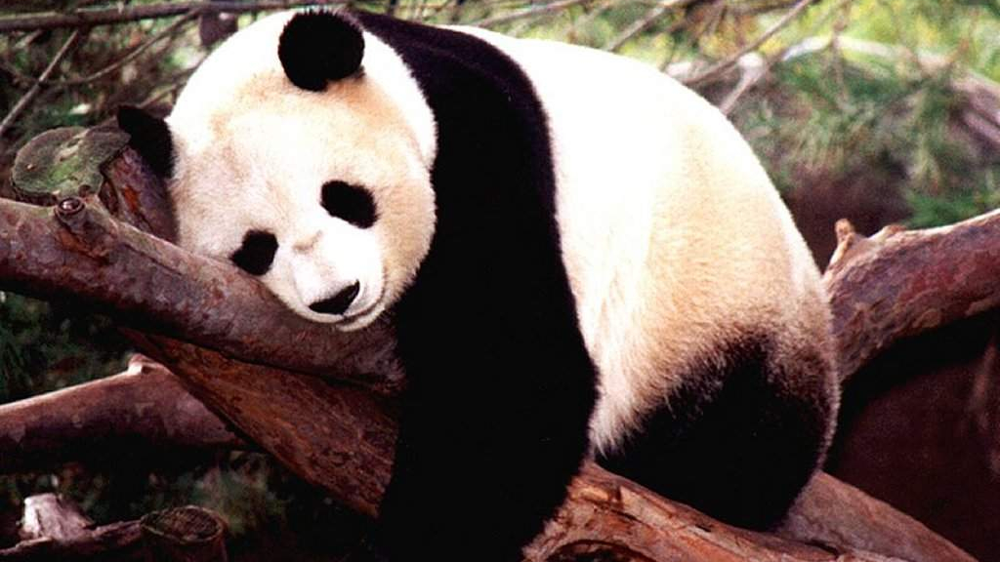

In [76]:
img = Image.open("../Data/Homework0/panda.jpg")
img

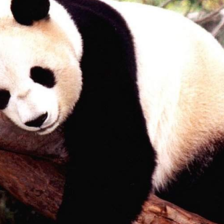

In [77]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [78]:
batch_t = torch.unsqueeze(img_t, 0)

In [79]:
out = mobnet(batch_t)
_, index = torch.max(out, 1)

In [80]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('giant panda, panda, panda bear, coon bear, Ailuropoda melanoleuca',
 99.48255920410156)

In [81]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('giant panda, panda, panda bear, coon bear, Ailuropoda melanoleuca',
  99.48255920410156),
 ('French bulldog', 0.1480681300163269),
 ('Boston bull, Boston terrier', 0.03717460483312607),
 ('capuchin, ringtail, Cebus capucinus', 0.031766995787620544),
 ('Siamese cat, Siamese', 0.031191986054182053)]

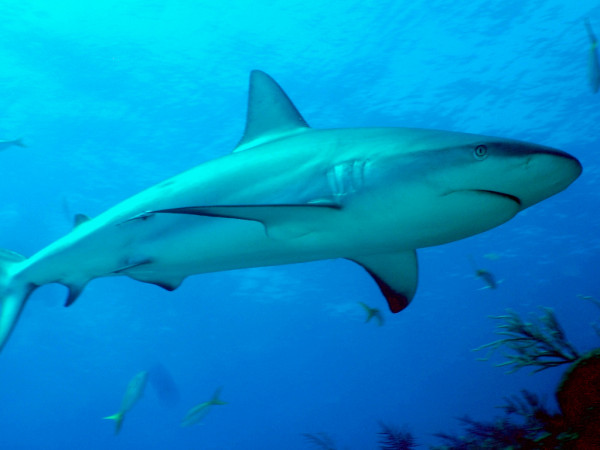

In [82]:
img = Image.open("../Data/Homework0/caribbean-reef-shark.jpg")
img

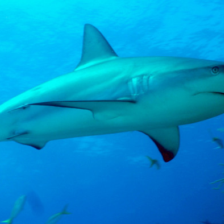

In [83]:
img_t = preprocess(img)
img_t2 = preprocess2(img)
img_t2

In [84]:
batch_t = torch.unsqueeze(img_t, 0)

In [85]:
out = mobnet(batch_t)
_, index = torch.max(out, 1)

In [86]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('hammerhead, hammerhead shark', 79.31352233886719)

In [87]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('hammerhead, hammerhead shark', 79.31352233886719),
 ('tiger shark, Galeocerdo cuvieri', 15.26162052154541),
 ('great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
  5.320621490478516),
 ('electric ray, crampfish, numbfish, torpedo', 0.07180054485797882),
 ('killer whale, killer, orca, grampus, sea wolf, Orcinus orca',
  0.014228451997041702)]

In [88]:
# Calculate the MACs and size of the mobilenet 
macs, params = get_model_complexity_info(mobnet, (3, 224, 224), as_strings=True,
                                           print_per_layer_stat=True, verbose=True)
print('{:<30}  {:<8}'.format('Computational complexity: ', macs))
print('{:<30}  {:<8}'.format('Number of parameters: ', params))

MobileNetV2(
  3.505 M, 100.000% Params, 0.32 GMac, 100.000% MACs, 
  (features): Sequential(
    2.224 M, 63.451% Params, 0.319 GMac, 99.600% MACs, 
    (0): ConvNormActivation(
      0.001 M, 0.026% Params, 0.012 GMac, 3.760% MACs, 
      (0): Conv2d(0.001 M, 0.025% Params, 0.011 GMac, 3.384% MACs, 3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(0.0 M, 0.002% Params, 0.001 GMac, 0.251% MACs, 32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(0.0 M, 0.000% Params, 0.0 GMac, 0.125% MACs, inplace=True)
    )
    (1): InvertedResidual(
      0.001 M, 0.026% Params, 0.012 GMac, 3.635% MACs, 
      (conv): Sequential(
        0.001 M, 0.026% Params, 0.012 GMac, 3.635% MACs, 
        (0): ConvNormActivation(
          0.0 M, 0.010% Params, 0.005 GMac, 1.504% MACs, 
          (0): Conv2d(0.0 M, 0.008% Params, 0.004 GMac, 1.128% MACs, 32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)